In [1]:
import pandas as pd

In [2]:
df = pd.read_csv('./data.csv')

In [3]:
df.head()

,article_id,source_id,source_name,author,title,description,url,url_to_image,published_at,content,category,full_content
0,89541,NaN,International Business Times,Paavan MATHEMA,UN Chief Urges World To 'Stop The Madness' Of ...,UN Secretary-General Antonio Guterres urged th...,https://www.ibtimes.com/un-chief-urges-world-s...,https://d.ibtimes.com/en/full/4496078/nepals-g...,2023-10-30 10:12:35.000000,UN Secretary-General Antonio Guterres urged th...,Nepal,UN Secretary-General Antonio Guterres urged th...
1,89542,NaN,Prtimes.jp,NaN,RANDEBOOよりワンランク上の大人っぽさが漂うニットとベストが新登場。,[株式会社Ainer]\nRANDEBOO（ランデブー）では2023年7月18日(火)より公...,https://prtimes.jp/main/html/rd/p/000000147.00...,https://prtimes.jp/i/32220/147/ogp/d32220-147-...,2023-10-06 04:40:02.000000,"RANDEBOO2023718()WEB2023 Autumn Winter \n""Nepa...",Nepal,NaN
2,89543,NaN,VOA News,webdesk@voanews.com (Agence France-Presse),UN Chief Urges World to 'Stop the Madness' of ...,UN Secretary-General Antonio Guterres urged th...,https://www.voanews.com/a/un-chief-urges-world...,https://gdb.voanews.com/01000000-0a00-0242-60f...,2023-10-30 10:53:30.000000,"Kathmandu, Nepal UN Secretary-General Antonio...",Nepal,NaN
3,89545,NaN,The Indian Express,Editorial,Sikkim warning: Hydroelectricity push must be ...,Ecologists caution against the adverse effects...,https://indianexpress.com/article/opinion/edit...,https://images.indianexpress.com/2023/10/edit-...,2023-10-06 01:20:24.000000,At least 14 persons lost their lives and more ...,Nepal,At least 14 persons lost their lives and more ...
4,89547,NaN,The Times of Israel,Jacob Magid,"200 foreigners, dual nationals cut down in Ham...","France lost 35 citizens, Thailand 33, US 31, U...",https://www.timesofisrael.com/200-foreigners-d...,https://static.timesofisrael.com/www/uploads/2...,2023-10-27 01:08:34.000000,"Scores of foreign citizens were killed, taken ...",Nepal,NaN


In [4]:
pd.set_option('display.max_rows', None)
df['category'].value_counts()

category
Stock                                    3999
Health                                   2594
Finance                                  2402
Technology                               2371
Real estate                              2352
Canada                                   2324
News                                     1852
COVID                                    1821
Education                                1771
Food                                     1613
Jobs                                     1562
Weather                                  1496
Travel                                   1451
Cars                                     1289
Science                                  1261
Asia                                     1242
India                                    1196
Music                                    1159
Politics                                 1156
Climate                                  1140
America                                  1135
Fashion                  

In [5]:
df.shape

(105375, 12)

## Data preprocessing

In [6]:
# Function to count words
def word_count(text):
    return len(str(text).split())

In [7]:
# Calculate average word count for each column
average_title_words = df['title'].apply(word_count).mean()
average_description_words = df['description'].apply(word_count).mean()
average_content_words = df['content'].apply(word_count).mean()
average_full_content_words = df['full_content'].apply(word_count).mean()

print(f"Average number of words in title: {average_title_words}")
print(f"Average number of words in description: {average_description_words}")
print(f"Average number of words in content: {average_content_words}")
print(f"Average number of words in full content: {average_full_content_words}")

Average number of words in title: 11.288816132858837
Average number of words in description: 31.989361803084222
Average number of words in content: 33.77114116251483
Average number of words in full content: 511.93448161328587


In [8]:
# Ensure 'description' contains only strings
df['description'] = df['description'].apply(lambda x: x if isinstance(x, str) else None)

# Drop rows where 'description' is None
df.dropna(subset=['description'], inplace=True)

# Drop duplicate rows based on 'description'
df.drop_duplicates(subset=['description'], inplace=True)
df.dropna(subset=['description', 'published_at'], inplace=True)

df = df[['published_at', 'description']]

In [9]:
df.shape

(98488, 2)

In [10]:
import spacy

In [11]:
# Load spaCy's English model
nlp = spacy.load('en_core_web_sm')

c:\Users\ShaheerAhmed\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [12]:
# Preprocess text: lemmatize, remove stop words and punctuation
def preprocess(text):
    doc = nlp(text)
    return ' '.join([token.lemma_ for token in doc if not token.is_stop and not token.is_punct])

df['description'] = df['description'].apply(preprocess)

## BERT topic modelling

In [13]:
import numpy as np
from bertopic import BERTopic
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from gensim.models import Word2Vec
import gensim.downloader as api
from collections import defaultdict

In [14]:
# Using CountVectorizer
vectorizer_1 = CountVectorizer(stop_words='english', min_df=5, max_df=0.9, ngram_range=(1, 2))
topic_model_1 = BERTopic(
    embedding_model="all-MiniLM-L6-v2",
    vectorizer_model=vectorizer_1,
    calculate_probabilities=True,
    n_gram_range=(1, 2)
)

In [15]:
# Using TF-IDF
vectorizer_2 = TfidfVectorizer(stop_words='english', min_df=5, max_df=0.9, ngram_range=(1, 2))
topic_model_2 = BERTopic(
    embedding_model="all-MiniLM-L6-v2",
    vectorizer_model=vectorizer_2,
    calculate_probabilities=True,
    n_gram_range=(1, 2)
)

In [16]:
# Using Word2Vec
word2vec_model = api.load("word2vec-google-news-300")

def document_to_vector(doc, model):
    words = doc.split()
    word_vectors = [model[word] for word in words if word in model]
    if word_vectors:
        return np.mean(word_vectors, axis=0)
    else:
        return np.zeros(model.vector_size)

# Transform the descriptions into embeddings
embeddings = np.array([document_to_vector(doc, word2vec_model) for doc in df['description']])
topic_model_3 = BERTopic(embedding_model=None)

In [17]:
# Fit the model on the descriptions column for each vectorizer
topics_1, probabilities_1 = topic_model_1.fit_transform(df['description'])
topics_2, probabilities_2 = topic_model_2.fit_transform(df['description'])
topics_3, probabilities_3 = topic_model_3.fit_transform(df['description'])

In [18]:
def calculate_topic_diversity(model, top_n_words=10):
    topics = model.get_topics()
    topic_words = [words[:top_n_words] for topic_id, words in topics.items()]
    
    # Flatten the list of topic words
    flat_topic_words = [word for sublist in topic_words for word, _ in sublist]
    
    # Count the frequency of each word
    word_counts = defaultdict(int)
    for word in flat_topic_words:
        word_counts[word] += 1
    
    # Calculate diversity as the proportion of unique words
    unique_words = len([word for word, count in word_counts.items() if count == 1])
    total_words = len(flat_topic_words)
    diversity_score = unique_words / total_words
    
    return diversity_score

#### Count Vectorizer results

In [19]:
print(topics_1)

[-1, 23, -1, 218, -1, -1, -1, 252, 23, -1, 79, -1, -1, 10, 23, -1, 23, 23, 23, 543, -1, -1, 107, -1, 23, -1, 102, 71, 409, 23, -1, 79, 23, -1, 573, -1, -1, 120, -1, -1, 23, 79, -1, -1, 71, 187, -1, -1, 178, 127, -1, -1, 45, -1, -1, -1, -1, -1, 519, -1, -1, -1, 178, 45, -1, 0, -1, -1, -1, 519, -1, 519, 1, 53, 1, -1, -1, -1, -1, -1, 1, 38, 15, -1, -1, 551, -1, -1, 605, -1, -1, 351, 1, -1, -1, -1, 1, 1, 72, -1, -1, 1, -1, 1, 1, 165, -1, 1, 1, -1, 1, -1, 561, -1, -1, -1, 519, -1, 183, -1, 3, 1, 1, -1, -1, -1, 356, -1, 1, -1, 1, 48, 186, 25, 290, -1, 23, -1, 1, 225, 53, -1, -1, 23, 301, -1, 225, -1, -1, -1, -1, 11, 48, -1, 526, -1, -1, -1, -1, -1, -1, -1, 16, -1, -1, -1, -1, -1, -1, -1, -1, 501, -1, -1, 321, -1, -1, -1, -1, -1, 48, -1, 107, 130, -1, 120, 94, -1, -1, 66, 283, 102, -1, -1, 48, 76, 23, -1, 76, 1, 76, 634, 79, 1, -1, 424, -1, 76, 76, 76, 76, 424, 76, -1, 80, 1, 76, -1, 1, 1, 76, 1, 1, 1, 1, 1, -1, 1, 1, -1, -1, -1, 1, 76, 1, -1, 76, 1, -1, 1, 1, -1, -1, 1, 1, 1, 1, 1, 1, -1, 11

In [20]:
topic_model_1.visualize_topics()

In [21]:
topic_model_1.visualize_barchart()

In [22]:
topic_freq = topic_model_1.get_topic_freq()
outliers = topic_freq['Count'][topic_freq['Topic']==-1].iloc[0]
print(f"{outliers} documents have not been classified")
print(f"The other {topic_freq['Count'].sum() - outliers} documents are {topic_freq['Topic'].shape[0]-1} topics")

21039 documents have not been classified
The other 31225 documents are 640 topics


In [23]:
topic_diversity_1 = calculate_topic_diversity(topic_model_1)
print(f"Topic Diversity: {topic_diversity_1:.4f}")

Topic Diversity: 0.4520


#### TF-IDF results

In [24]:
print(topics_2)

[-1, 24, -1, 55, -1, -1, -1, -1, 24, -1, 74, 55, -1, 12, 24, -1, 24, 24, 24, 518, -1, 223, 115, -1, 24, -1, 262, 37, 431, 24, 100, 74, 24, -1, 471, -1, -1, -1, -1, -1, 24, 74, 24, -1, 37, 166, 227, -1, 227, -1, -1, -1, 57, -1, -1, -1, -1, -1, 482, -1, -1, -1, 227, 57, -1, 0, -1, -1, 116, 482, -1, 482, 3, 25, 3, -1, -1, -1, -1, 48, 3, -1, 18, -1, -1, 38, 3, -1, 25, -1, -1, -1, 3, -1, -1, 47, -1, 3, -1, -1, -1, 3, -1, 3, 3, 530, -1, 3, 3, -1, 3, -1, 368, -1, -1, -1, 482, -1, 174, -1, 6, 3, -1, -1, -1, -1, 309, -1, 3, -1, 3, -1, 171, 21, 420, -1, 24, -1, 3, -1, 25, -1, -1, 24, -1, -1, -1, 54, -1, -1, -1, 15, 126, -1, -1, -1, -1, -1, 54, -1, 196, -1, 39, -1, -1, -1, -1, -1, -1, -1, -1, 535, -1, -1, 196, 479, -1, 5, -1, -1, -1, -1, 115, 124, -1, 132, 103, -1, -1, 70, 284, -1, 144, -1, 126, 67, 24, -1, 67, 3, 67, 142, 74, 3, -1, 437, 99, 67, 67, 67, 67, 437, 67, -1, -1, 3, 67, 3, 3, 3, 67, 3, 3, 3, 3, 3, -1, 3, 3, 24, -1, 22, 3, 67, 3, -1, 67, -1, -1, 3, 3, -1, -1, 3, -1, 3, -1, 3, 3, -1, 15

In [25]:
topic_model_2.visualize_topics()

In [26]:
topic_model_2.visualize_barchart()

In [27]:
topic_freq = topic_model_2.get_topic_freq()
outliers = topic_freq['Count'][topic_freq['Topic']==-1].iloc[0]
print(f"{outliers} documents have not been classified")
print(f"The other {topic_freq['Count'].sum() - outliers} documents are {topic_freq['Topic'].shape[0]-1} topics")

20506 documents have not been classified
The other 31758 documents are 649 topics


In [28]:
topic_diversity_2 = calculate_topic_diversity(topic_model_2)
print(f"Topic Diversity: {topic_diversity_2:.4f}")

Topic Diversity: 0.5505


#### Word2Vec results

In [29]:
print(topics_3)

[-1, 25, -1, 59, -1, -1, -1, 186, 25, -1, 204, 59, -1, 17, 25, -1, 25, 25, 25, 541, 625, 106, 141, 565, 25, -1, 136, 34, 463, 25, -1, 204, 25, -1, -1, 43, -1, -1, -1, -1, 25, 204, -1, 45, 34, 150, 45, -1, 248, 126, 45, -1, 45, -1, 45, -1, 36, -1, 504, 45, -1, 14, 248, 45, -1, 0, -1, -1, -1, 504, -1, 504, 1, 24, 1, -1, -1, -1, -1, -1, 1, 60, 14, -1, -1, 478, -1, 603, 24, -1, -1, 44, 1, -1, -1, -1, 1, 1, 35, 603, -1, 1, -1, 1, 1, 148, 603, 1, 1, 35, 1, -1, 600, -1, -1, -1, 504, -1, 168, 67, 16, 1, -1, -1, -1, -1, 280, -1, 1, -1, 1, -1, 183, -1, 261, -1, 25, -1, 1, 191, 24, -1, -1, 25, -1, -1, 191, -1, -1, -1, -1, 11, 85, -1, -1, -1, 105, -1, -1, 460, -1, -1, 19, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, 173, -1, -1, 4, -1, -1, 85, -1, 141, 131, -1, -1, 93, 117, -1, 77, 276, -1, 191, -1, 85, 80, 25, -1, 80, 1, 80, 134, 204, 1, -1, 417, -1, 80, 80, 80, 80, 417, 80, -1, 100, 1, 80, 1, -1, 1, 80, 1, 1, 1, 1, 1, -1, 1, 1, -1, -1, -1, 1, 80, 1, -1, 80, 1, -1, 1, 1, -1, -1, 1, 1, 1, 1, 1, 1, 

In [30]:
topic_model_3.visualize_topics()

In [31]:
topic_model_3.visualize_barchart()

In [32]:
topic_freq = topic_model_3.get_topic_freq()
outliers = topic_freq['Count'][topic_freq['Topic']==-1].iloc[0]
print(f"{outliers} documents have not been classified")
print(f"The other {topic_freq['Count'].sum() - outliers} documents are {topic_freq['Topic'].shape[0]-1} topics")

20572 documents have not been classified
The other 31692 documents are 640 topics


In [33]:
topic_diversity_3 = calculate_topic_diversity(topic_model_3)
print(f"Topic Diversity: {topic_diversity_3:.4f}")

Topic Diversity: 0.5727


## LDA for topic modelling

In [34]:
import re
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer
import pyLDAvis
import pyLDAvis.lda_model
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from gensim.models import CoherenceModel
from gensim.corpora.dictionary import Dictionary

In [35]:
# Clean the text data
def clean_text(text):
    text = re.sub(r'\s+', ' ', text)  # Remove extra spaces
    text = re.sub(r'\W', ' ', text)   # Remove special characters
    text = re.sub(r'\d', '', text)    # Remove digits
    return text.lower()

df['cleaned_description'] = df['description'].apply(clean_text)

In [36]:
# Your preprocessed data
count_vectorizer = CountVectorizer(max_df=0.9, min_df=2, stop_words='english')
count_data = count_vectorizer.fit_transform(df['cleaned_description'])

# Function to calculate perplexity and coherence
def compute_metrics(data_vectorized, texts, start, end, step):
    perplexities = []
    coherence_scores = []
    topic_numbers = []

    for n in range(start, end, step):
        lda_model = LatentDirichletAllocation(n_components=n, random_state=0)
        lda_model.fit(data_vectorized)

        # Perplexity
        perplexity = lda_model.perplexity(data_vectorized)
        perplexities.append(perplexity)
        
        # Prepare to compute coherence score
        lda_topics = lda_model.components_
        topic_words = [[count_vectorizer.get_feature_names_out()[i] for i in topic.argsort()[-10:]] for topic in lda_topics]
        
        # Create gensim dictionary and corpus
        dictionary = Dictionary([doc.split() for doc in texts])
        corpus = [dictionary.doc2bow(text.split()) for text in texts]
        
        # Coherence
        coherence_model = CoherenceModel(topics=topic_words, texts=[text.split() for text in texts], dictionary=dictionary, coherence='c_v')
        coherence_score = coherence_model.get_coherence()
        coherence_scores.append(coherence_score)
        
        # Store the number of topics used
        topic_numbers.append(n)
    
    return perplexities, coherence_scores, topic_numbers

In [37]:
# Compute metrics for a range of topic numbers
start, end, step = 1, 250, 10
perplexities, coherence_scores, topic_numbers = compute_metrics(count_data, df['cleaned_description'], start, end, step)

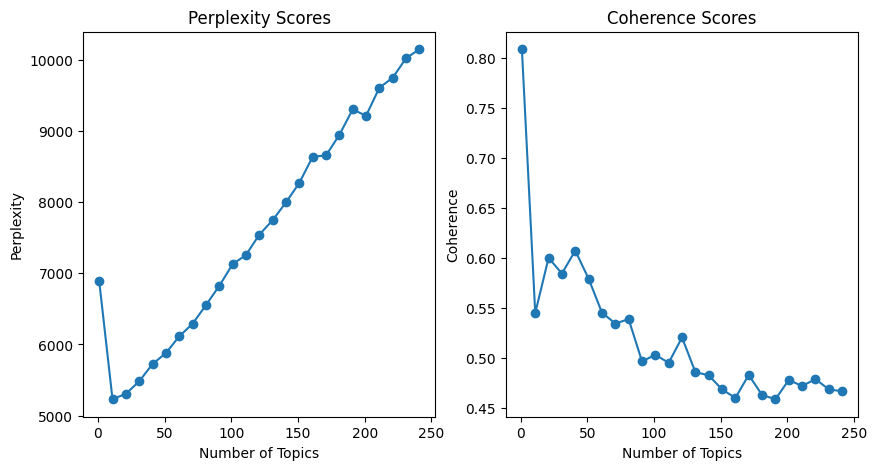

In [38]:
# Plotting
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.plot(topic_numbers, perplexities, marker='o')
plt.title('Perplexity Scores')
plt.xlabel('Number of Topics')
plt.ylabel('Perplexity')

plt.subplot(1, 2, 2)
plt.plot(topic_numbers, coherence_scores, marker='o')
plt.title('Coherence Scores')
plt.xlabel('Number of Topics')
plt.ylabel('Coherence')

plt.show()

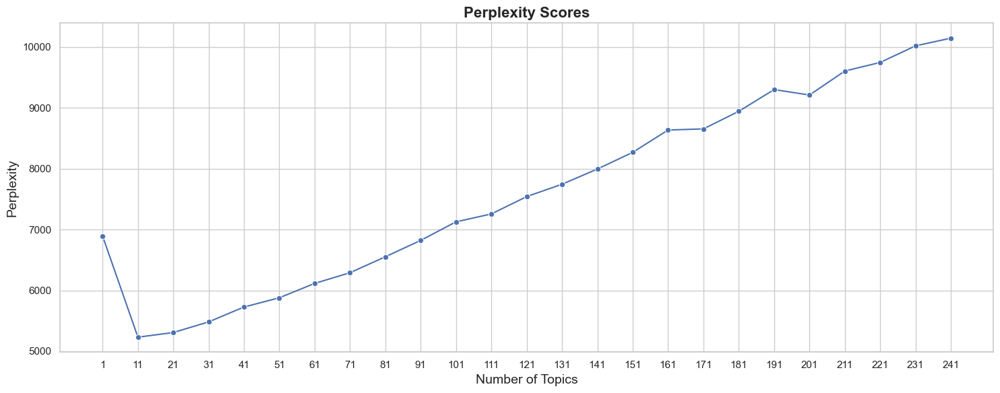

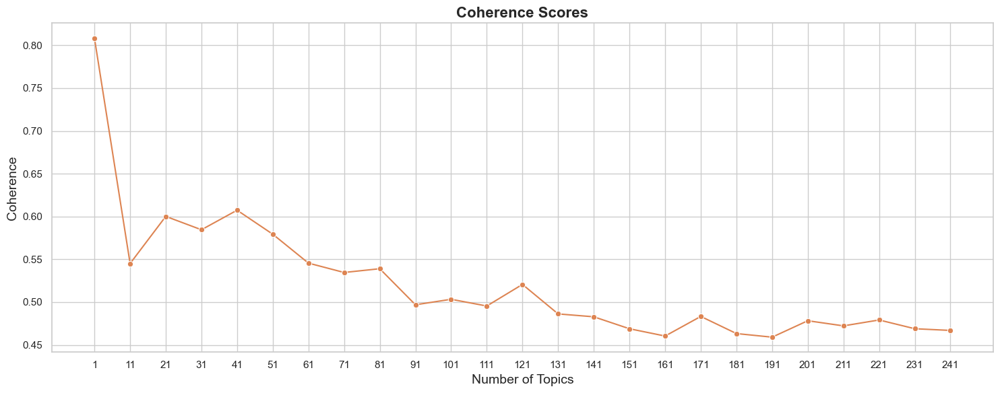

In [40]:
# Set Seaborn style
sns.set(style="whitegrid")

# Define color palette
palette = sns.color_palette("deep")

# Plot 1: Perplexity Scores
plt.figure(figsize=(15, 6))
sns.lineplot(x=topic_numbers, y=perplexities, marker='o', color=palette[0])
plt.title('Perplexity Scores', fontsize=16, fontweight='bold')
plt.xlabel('Number of Topics', fontsize=14)
plt.ylabel('Perplexity', fontsize=14)
plt.xticks(topic_numbers)
plt.tight_layout()
plt.show()

# Plot 2: Coherence Scores
plt.figure(figsize=(15, 6))
sns.lineplot(x=topic_numbers, y=coherence_scores, marker='o', color=palette[1])
plt.title('Coherence Scores', fontsize=16, fontweight='bold')
plt.xlabel('Number of Topics', fontsize=14)
plt.ylabel('Coherence', fontsize=14)
plt.xticks(topic_numbers)
plt.tight_layout()
plt.show()

In [41]:
# Vectorize the text data
count_vectorizer = CountVectorizer(max_df=0.9, min_df=2, stop_words='english')
count_data = count_vectorizer.fit_transform(df['cleaned_description'])

# Apply LDA
lda = LatentDirichletAllocation(n_components=20, random_state=0)
lda.fit(count_data)

# Get the topics for each document
df['topic'] = np.argmax(lda.transform(count_data), axis=1)

In [42]:
# Prepare the visualization
pyLDAvis.enable_notebook()
panel = pyLDAvis.lda_model.prepare(lda, count_data, count_vectorizer, mds='tsne')

# Display the interactive visualization
pyLDAvis.display(panel)

## Predicting Stock Market Movements

#### EDA and data processing for VIX prices

In [43]:
import yfinance as yf

In [44]:
vix = yf.Ticker("^VIX")

In [45]:
vix = vix.history(period="max")

In [46]:
vix.head()

,Open,High,Low,Close,Volume,Dividends,Stock Splits
Date,,,,,,,
1990-01-02 00:00:00-06:00,17.240000,17.240000,17.240000,17.240000,0,0.0,0.0
1990-01-03 00:00:00-06:00,18.190001,18.190001,18.190001,18.190001,0,0.0,0.0
1990-01-04 00:00:00-06:00,19.219999,19.219999,19.219999,19.219999,0,0.0,0.0
1990-01-05 00:00:00-06:00,20.110001,20.110001,20.110001,20.110001,0,0.0,0.0
1990-01-08 00:00:00-06:00,20.260000,20.260000,20.260000,20.260000,0,0.0,0.0


In [47]:
vix.index

DatetimeIndex(['1990-01-02 00:00:00-06:00', '1990-01-03 00:00:00-06:00',
               '1990-01-04 00:00:00-06:00', '1990-01-05 00:00:00-06:00',
               '1990-01-08 00:00:00-06:00', '1990-01-09 00:00:00-06:00',
               '1990-01-10 00:00:00-06:00', '1990-01-11 00:00:00-06:00',
               '1990-01-12 00:00:00-06:00', '1990-01-15 00:00:00-06:00',
               ...
               '2024-08-12 00:00:00-05:00', '2024-08-13 00:00:00-05:00',
               '2024-08-14 00:00:00-05:00', '2024-08-15 00:00:00-05:00',
               '2024-08-16 00:00:00-05:00', '2024-08-19 00:00:00-05:00',
               '2024-08-20 00:00:00-05:00', '2024-08-21 00:00:00-05:00',
               '2024-08-22 00:00:00-05:00', '2024-08-23 00:00:00-05:00'],
              dtype='datetime64[ns, America/Chicago]', name='Date', length=8728, freq=None)

<Axes: xlabel='Date'>

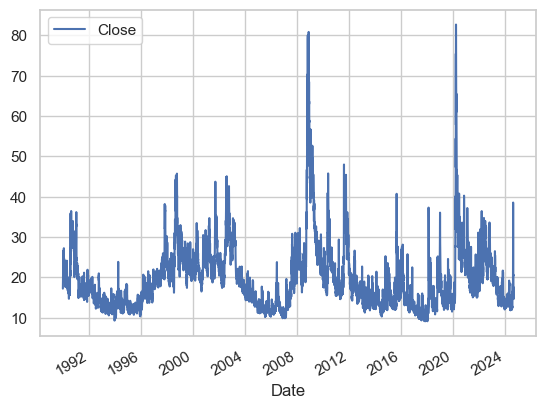

In [48]:
# plotting vix prices over time
vix.plot.line(y="Close", use_index=True)

In [49]:
del vix['Dividends']
del vix['Stock Splits']

In [50]:
# Create lagged features for VIX
for lag in range(1, 6):
    vix[f'vix_lag_{lag}'] = vix['Close'].shift(lag)

In [51]:
# Create target columns for the next `num_days` days
num_days = 10
for days in range(1, num_days + 1):
    vix[f'Target_price_{days}'] = vix['Close'].shift(-days)
    vix[f'Target_binary_{days}'] = (vix['Close'].shift(-days) > vix['Close']).astype(int)

In [52]:
# Drop rows with NaN values (introduced by lagging)
vix = vix.dropna()

In [53]:
vix = vix.loc['2023-10-01':'2023-11-29'].copy()

In [54]:
# Add rolling mean and SD variables
vix['vix_rolling_mean_3'] = vix['Close'].rolling(window=3).mean()
vix['vix_rolling_std_3'] = vix['Close'].rolling(window=3).std()
vix['vix_rolling_mean_7'] = vix['Close'].rolling(window=7).mean()
vix['vix_rolling_std_7'] = vix['Close'].rolling(window=7).std()

# Drop rows with NaN values (introduced by rolling windows)
vix = vix.dropna()

#### Merging topics with VIX historical data and feature engineering

In [55]:
# Function to parse dates with multiple formats
def parse_dates(date_str):
    for fmt in ("%Y-%m-%d %H:%M:%S", "%Y-%m-%dT%H:%M:%SZ", "%Y-%m-%d %H:%M:%S.%f"):
        try:
            return pd.to_datetime(date_str, format=fmt)
        except ValueError:
            continue
    return pd.NaT

# Apply the function to the 'published_at' column
df['published_at'] = df['published_at'].apply(parse_dates)
df['date'] = df['published_at'].dt.date

In [56]:
df = df.groupby('date')['topic'].apply(lambda x: x.value_counts(normalize=True)).unstack().fillna(0)

In [57]:
# Ensure the index of df2 is also a date (not datetime) and remove timezone information
vix['date'] = vix.index.tz_localize(None).date

# Ensure df has its index set as date
df.index = pd.to_datetime(df.index).date

# Merge based on the date
df_merged = vix.merge(df, how='left', left_on='date', right_index=True).fillna(0)

# Set the original index back
df_merged.index = vix.index

# Drop the redundant 'date' column after merge
df_merged = df_merged.drop(columns=['date'])

In [58]:
# Convert integer column names to string column names
df_merged.columns = [str(col) for col in df_merged.columns]

In [59]:
# 80/20 train-test split
split_index = int(len(df_merged) * 0.8)
train = df_merged.iloc[:split_index]
test = df_merged.iloc[split_index:]

#### XGBoost Model

In [60]:
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

In [66]:
# Target columns to exclude from predictors
exclude_columns = ['Target_price_1', 'Target_price_2', 'Target_price_3', 'Target_price_4', 'Target_price_5', 'Target_price_6', 'Target_price_7', 'Target_price_8', 'Target_price_9', 'Target_price_10', 'Target_binary_1', 'Target_binary_2', 'Target_binary_3', 'Target_binary_4', 'Target_binary_5', 'Target_binary_6', 'Target_binary_7', 'Target_binary_8', 'Target_binary_9', 'Target_binary_10']

In [67]:
# Initialize lists to store MSE and Relative Error for each prediction horizon
mse_values = []
relative_error_values = []

# Train models for each `num_days`
for days in range(1, num_days + 1):
    X_train = train.drop(columns=exclude_columns)
    X_test = test.drop(columns=exclude_columns)
    y_train = train[f'Target_price_{days}']
    y_test = test[f'Target_price_{days}']
    
    # Train the XGBoost model
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.1)
    model.fit(X_train, y_train)
    
    # Make predictions
    y_pred = model.predict(X_test)
    
    # Evaluate the model
    mse = mean_squared_error(y_test, y_pred)
    mse_values.append(mse)  # Store MSE for each prediction horizon
    
    # Calculate relative error
    min_value = df_merged[f'Target_price_{days}'].min()
    max_value = df_merged[f'Target_price_{days}'].max()
    rangeVal = max_value - min_value
    relative_error = (mse / rangeVal) * 100
    relative_error_values.append(relative_error)  # Store Relative Error for each prediction horizon
    
    print(f'Mean Squared Error for predicting {days} days ahead: {mse}')
    print(f'Relative Error: {relative_error}')

Mean Squared Error for predicting 1 days ahead: 1.563052251005388
Relative Error: 16.897863915199743
Mean Squared Error for predicting 2 days ahead: 0.6516565193377346
Relative Error: 7.0449360705241135
Mean Squared Error for predicting 3 days ahead: 0.8849700168593699
Relative Error: 9.567244411888893
Mean Squared Error for predicting 4 days ahead: 2.421883164269616
Relative Error: 26.182523394222883
Mean Squared Error for predicting 5 days ahead: 0.12117550205778116
Relative Error: 1.310005562713165
Mean Squared Error for predicting 6 days ahead: 0.0903577229782968
Relative Error: 0.9768403491261873
Mean Squared Error for predicting 7 days ahead: 0.19042050847212977
Relative Error: 2.0344074237001544
Mean Squared Error for predicting 8 days ahead: 0.06683673367854226
Relative Error: 0.7140677664527807
Mean Squared Error for predicting 9 days ahead: 0.1628060137503553
Relative Error: 1.769630437490723
Mean Squared Error for predicting 10 days ahead: 0.14266590920829003
Relative Error:

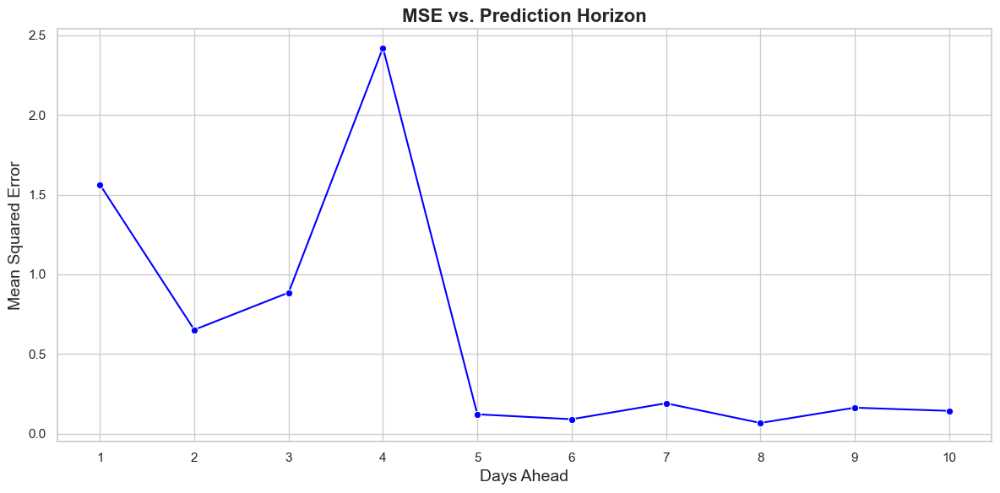

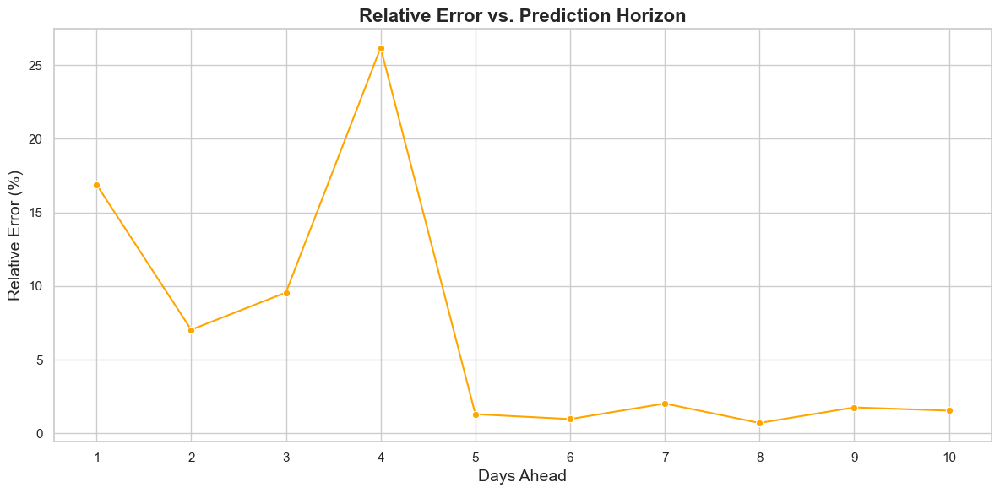

In [68]:
# Set Seaborn style
sns.set(style="whitegrid")

# Plot MSE over prediction horizon
plt.figure(figsize=(12, 6))
sns.lineplot(x=range(1, num_days + 1), y=mse_values, marker='o', color='blue')
plt.title('MSE vs. Prediction Horizon', fontsize=16, fontweight='bold')
plt.xlabel('Days Ahead', fontsize=14)
plt.ylabel('Mean Squared Error', fontsize=14)
plt.xticks(range(1, num_days + 1))
plt.tight_layout()
plt.show()

# Plot Relative Error over prediction horizon
plt.figure(figsize=(12, 6))
sns.lineplot(x=range(1, num_days + 1), y=relative_error_values, marker='o', color='orange')
plt.title('Relative Error vs. Prediction Horizon', fontsize=16, fontweight='bold')
plt.xlabel('Days Ahead', fontsize=14)
plt.ylabel('Relative Error (%)', fontsize=14)
plt.xticks(range(1, num_days + 1))
plt.tight_layout()
plt.show()

In [69]:
# Cross validation
from sklearn.model_selection import TimeSeriesSplit

# Initialize lists to store MSE and Relative Error for each prediction horizon
mse_values = []
relative_error_values = []

# Define the number of splits for cross-validation
n_splits = 5
tscv = TimeSeriesSplit(n_splits=n_splits)

# Number of days ahead you want to predict
num_days = 10  # Adjust this according to your specific horizons

# Dictionary to store results for each time horizon
results = {}

# Variables to track the ideal time horizon
best_horizon = None
lowest_mse = float('inf')
lowest_relative_error = float('inf')

for days in range(1, num_days + 1):
    target_column = f'Target_price_{days}'

    mse_scores = []
    relative_error_scores = []

    for train_index, test_index in tscv.split(df_merged):
        train, test = df_merged.iloc[train_index], df_merged.iloc[test_index]

        X_train = train.drop(columns=exclude_columns)
        X_test = test.drop(columns=exclude_columns)
        y_train = train[target_column]
        y_test = test[target_column]

        # Train the XGBoost model
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.1)
        model.fit(X_train, y_train)

        # Make predictions
        y_pred = model.predict(X_test)

        # Evaluate the model
        mse = mean_squared_error(y_test, y_pred)
        mse_scores.append(mse)

        # Calculate relative error
        min_value = df_merged[target_column].min()
        max_value = df_merged[target_column].max()
        rangeVal = max_value - min_value
        relative_error = (mse / rangeVal) * 100
        relative_error_scores.append(relative_error)

    # Calculate the average MSE and Relative Error for this time horizon
    average_mse = np.mean(mse_scores)
    average_relative_error = np.mean(relative_error_scores)

    # Store the results
    results[target_column] = {
        'Average MSE': average_mse,
        'Average Relative Error': average_relative_error
    }

    # Check if this horizon has the lowest MSE and Relative Error
    if average_mse < lowest_mse and average_relative_error < lowest_relative_error:
        best_horizon = target_column
        lowest_mse = average_mse
        lowest_relative_error = average_relative_error


    mse_values.append(average_mse)
    relative_error_values.append(average_relative_error)

# Print the results for all time horizons
for horizon, metrics in results.items():
    print(f'{horizon} - Average MSE: {metrics["Average MSE"]:.4f}, Average Relative Error: {metrics["Average Relative Error"]:.2f}%')

# Print the ideal time horizon
print(f'\nThe ideal time horizon for prediction is {best_horizon} with an Average MSE of {lowest_mse:.4f} and Average Relative Error of {lowest_relative_error:.2f}%')

Target_1 - Average MSE: 6.0517, Average Relative Error: 65.42%
Target_2 - Average MSE: 7.2063, Average Relative Error: 77.91%
Target_3 - Average MSE: 6.6786, Average Relative Error: 72.20%
Target_4 - Average MSE: 9.4660, Average Relative Error: 102.34%
Target_5 - Average MSE: 7.4614, Average Relative Error: 80.66%
Target_6 - Average MSE: 6.6411, Average Relative Error: 71.80%
Target_7 - Average MSE: 6.7757, Average Relative Error: 72.39%
Target_8 - Average MSE: 14.4314, Average Relative Error: 154.18%
Target_9 - Average MSE: 14.2747, Average Relative Error: 155.16%
Target_10 - Average MSE: 16.1509, Average Relative Error: 175.55%

The ideal time horizon for prediction is Target_1 with an Average MSE of 6.0517 and Average Relative Error of 65.42%


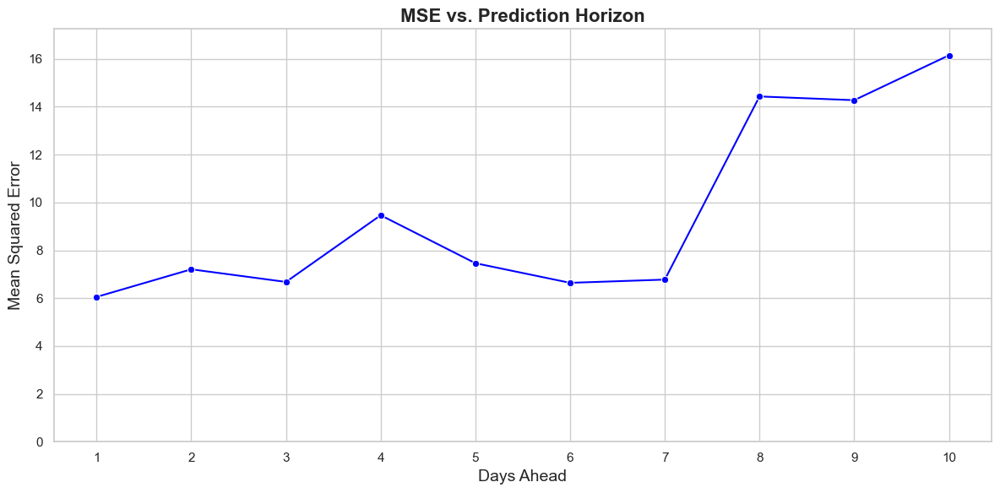

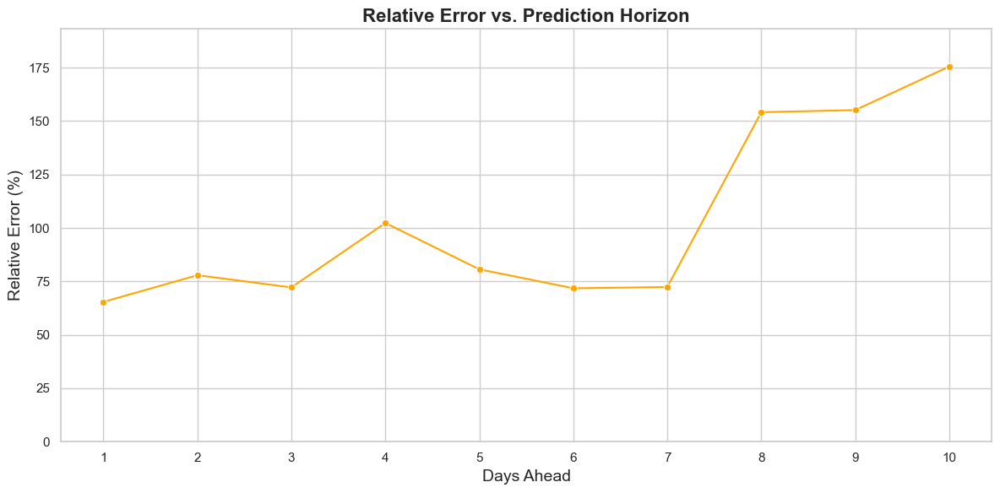

In [70]:
# Set Seaborn style
sns.set(style="whitegrid")

# Plot MSE over prediction horizon
plt.figure(figsize=(12, 6))
sns.lineplot(x=range(1, num_days + 1), y=mse_values, marker='o', color='blue')
plt.title('MSE vs. Prediction Horizon', fontsize=16, fontweight='bold')
plt.xlabel('Days Ahead', fontsize=14)
plt.ylabel('Mean Squared Error', fontsize=14)
plt.xticks(range(1, num_days + 1))
plt.ylim(0, max(mse_values) + 1.1) 
plt.tight_layout()
plt.show()

# Plot Relative Error over prediction horizon
plt.figure(figsize=(12, 6))
sns.lineplot(x=range(1, num_days + 1), y=relative_error_values, marker='o', color='orange')
plt.title('Relative Error vs. Prediction Horizon', fontsize=16, fontweight='bold')
plt.xlabel('Days Ahead', fontsize=14)
plt.ylabel('Relative Error (%)', fontsize=14)
plt.xticks(range(1, num_days + 1))
plt.ylim(0, max(relative_error_values) * 1.1) 
plt.tight_layout()
plt.show()

#### Logistic Regression

In [71]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import precision_score, accuracy_score, classification_report

In [73]:
# Initialize lists to store the precision and accuracy for each time horizon
precision_scores = []
accuracy_scores = []
time_horizons = list(range(1, num_days + 1))

# Train models for each `num_days`
for days in time_horizons:
    X_train = train.drop(columns=exclude_columns)
    X_test = test.drop(columns=exclude_columns)
    y_train = train[f'Target_binary_{days}']
    y_test = test[f'Target_binary_{days}']
    
    # Train the model
    model = LogisticRegression(max_iter=1000, random_state=1)
    model.fit(X_train, y_train)
        
    # Make predictions
    preds = model.predict(X_test)

    # Evaluate the model
    precision = precision_score(y_test, preds, zero_division=0)  # Set zero_division to 0 or 1
    accuracy = accuracy_score(y_test, preds)

    # Print evaluation metrics
    print(f"Days ahead: {days}")
    print(f"Precision Score: {precision}")
    print(f"Accuracy Score: {accuracy}")
    print(classification_report(y_test, preds, zero_division=0))  # Set zero_division to 0 or 1

    # Store the results
    precision_scores.append(precision)
    accuracy_scores.append(accuracy)

Days ahead: 1
Precision Score: 0.25
Accuracy Score: 0.25
              precision    recall  f1-score   support

           0       0.00      0.00      0.00         6
           1       0.25      1.00      0.40         2

    accuracy                           0.25         8
   macro avg       0.12      0.50      0.20         8
weighted avg       0.06      0.25      0.10         8

Days ahead: 2
Precision Score: 0.5
Accuracy Score: 0.625
              precision    recall  f1-score   support

           0       0.67      0.80      0.73         5
           1       0.50      0.33      0.40         3

    accuracy                           0.62         8
   macro avg       0.58      0.57      0.56         8
weighted avg       0.60      0.62      0.60         8

Days ahead: 3
Precision Score: 0.4
Accuracy Score: 0.5
              precision    recall  f1-score   support

           0       0.67      0.40      0.50         5
           1       0.40      0.67      0.50         3

    accuracy 

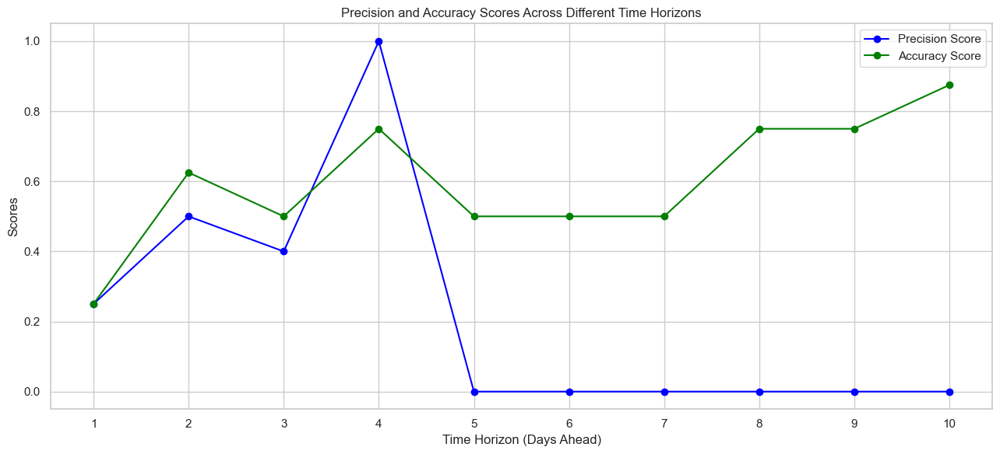

In [74]:
# Plotting the Precision and Accuracy Scores
plt.figure(figsize=(13, 6))
plt.plot(time_horizons, precision_scores, marker='o', linestyle='-', color='blue', label='Precision Score')
plt.plot(time_horizons, accuracy_scores, marker='o', linestyle='-', color='green', label='Accuracy Score')

plt.title('Precision and Accuracy Scores Across Different Time Horizons')
plt.xlabel('Time Horizon (Days Ahead)')
plt.ylabel('Scores')
plt.xticks(time_horizons)  # Ensure each time horizon is labeled
plt.legend(loc='best')
plt.grid(True)
plt.tight_layout()

# Show the plot
plt.show()

In [75]:
# Cross-validation
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, precision_score, classification_report
import numpy as np
import pprint

# Define the parameter grid for GridSearchCV
param_grid = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization strength
    'solver': ['liblinear', 'saga'],  # Solver algorithms
    'penalty': ['l1', 'l2'],  # Regularization types
    'max_iter': [100, 200, 300]  # Maximum number of iterations
}


# Initialize list to store results
results = []
accuracies=[]
precisions=[]

# Loop over each target (Target_1 to Target_10)
for days in range(1, 11):
    print(f"Evaluating for Target_{days} (Days ahead: {days})")
    
    # Define the target variable for the current day
    y_train = train[f'Target_binary_{days}']
    y_test = test[f'Target_binary_{days}']
    
    # Initialize the Logistic Regression model
    logreg_model = LogisticRegression()
    
    # Initialize GridSearchCV
    grid_search = GridSearchCV(estimator=logreg_model, param_grid=param_grid, cv=3, scoring='accuracy', verbose=0, n_jobs=-1)
    
    # Fit GridSearchCV
    grid_search.fit(X_train, y_train)
    
    # Best model for the current target
    best_model = grid_search.best_estimator_
    
    # Make predictions with the best model
    y_pred_best = best_model.predict(X_test)
    
    # Evaluate the best model
    accuracy_best = accuracy_score(y_test, y_pred_best)
    
    # Handle precision when no positive predictions are made
    precision_best = precision_score(y_test, y_pred_best, zero_division=1)  # Avoids precision being 0 if no true positives
    
    # Print the results
    print(f'Best Model Accuracy for Target_{days}: {accuracy_best}')
    print(f'Best Model Precision for Target_{days}: {precision_best}')
    accuracies.append(accuracy_best)
    precisions.append(precision_best)
    
    # Save the results
    results.append({
        'Days_Ahead': days,
        'Best_Parameters': grid_search.best_params_,
        'Accuracy': accuracy_best,
        'Precision': precision_best
    })

# Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)

# Find the ideal target based on the highest precision and accuracy
ideal_target = results_df.loc[results_df[['Precision', 'Accuracy']].mean(axis=1).idxmax()]

print("\nIdeal Target Based on Combined Precision and Accuracy:")
print(ideal_target)
pprint.pprint(ideal_target['Best_Parameters'])

Evaluating for Target_1 (Days ahead: 1)
Best Model Accuracy for Target_1: 0.75
Best Model Precision for Target_1: 1.0
Evaluating for Target_2 (Days ahead: 2)
Best Model Accuracy for Target_2: 0.625
Best Model Precision for Target_2: 1.0
Evaluating for Target_3 (Days ahead: 3)
Best Model Accuracy for Target_3: 0.625
Best Model Precision for Target_3: 1.0
Evaluating for Target_4 (Days ahead: 4)
Best Model Accuracy for Target_4: 0.625
Best Model Precision for Target_4: 1.0
Evaluating for Target_5 (Days ahead: 5)
Best Model Accuracy for Target_5: 0.5
Best Model Precision for Target_5: 1.0
Evaluating for Target_6 (Days ahead: 6)
Best Model Accuracy for Target_6: 0.5
Best Model Precision for Target_6: 1.0
Evaluating for Target_7 (Days ahead: 7)
Best Model Accuracy for Target_7: 0.5
Best Model Precision for Target_7: 1.0
Evaluating for Target_8 (Days ahead: 8)
Best Model Accuracy for Target_8: 0.75
Best Model Precision for Target_8: 1.0
Evaluating for Target_9 (Days ahead: 9)
Best Model Accur

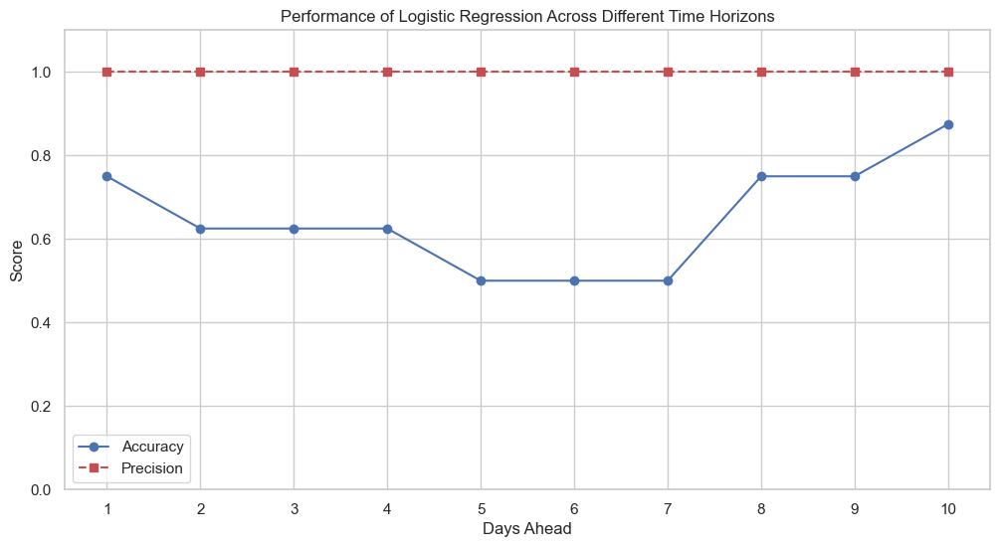

In [76]:
import matplotlib.pyplot as plt
import pandas as pd

days_ahead = list(range(1, 11))

# Create a DataFrame for easier plotting
results_df = pd.DataFrame({
    'Days Ahead': days_ahead,
    'Accuracy': accuracies,
    'Precision': precisions
})

# Plotting
plt.figure(figsize=(12, 6))

# Plot accuracy
plt.plot(results_df['Days Ahead'], results_df['Accuracy'], marker='o', linestyle='-', color='b', label='Accuracy')

# Plot precision
plt.plot(results_df['Days Ahead'], results_df['Precision'], marker='s', linestyle='--', color='r', label='Precision')

# Adding titles and labels
plt.title('Performance of Logistic Regression Across Different Time Horizons')
plt.xlabel('Days Ahead')
plt.ylabel('Score')
plt.legend()
plt.grid(True)
plt.xticks(days_ahead)

plt.ylim(0, max(max(accuracies), max(precisions)) * 1.1)

# Show plot
plt.show()